<a href="https://colab.research.google.com/github/sandeepsaha/ML-/blob/master/Copy_of_NYC_Property_Sales.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src="https://shwetkm.github.io/upxlogo.png"></img>


# Case study 2: Linear regression model to predict sales price of properties

## Business Objective 

This dataset contains properties sold in New York City over a 12-month period from September 2016 to September 2017. The objective is to build a model to predict sale value in the future.

## Load Dataset

In [0]:
#Download dataset
!wget -q https://www.dropbox.com/s/6tc7e6rc395c7jz/nyc-property-sales.zip

In [0]:
#Unzip the data
!unzip nyc-property-sales.zip > /dev/null; echo " done."

 done.


In [0]:
!ls

nyc-property-sales.zip	nyc-rolling-sales.csv  sample_data


In [0]:
#Install Packages

!pip -q install plotly-express
!pip -q install shap
!pip -q install eli5
!pip -q install lime

     |████████████████████████████████| 81kB 3.1MB/s 
     |████████████████████████████████| 41.5MB 812kB/s 
     |████████████████████████████████| 235kB 2.7MB/s 
     |████████████████████████████████| 102kB 2.7MB/s 
     |████████████████████████████████| 276kB 2.6MB/s 


## Import Packages

In [0]:
#Import basic packages

import warnings
warnings.filterwarnings("ignore")
import time
import pandas as pd               
import numpy as np
import pickle

from sklearn.model_selection import train_test_split   #splitting data
from pylab import rcParams
from sklearn.linear_model import LinearRegression         #linear regression
from sklearn.metrics.regression import mean_squared_error #error metrics
from sklearn.metrics import mean_absolute_error

import seaborn as sns                       #visualisation
import matplotlib.pyplot as plt             #visualisation

%matplotlib inline     
sns.set(color_codes=True)




In [0]:
# Code for displaying plotly express plots inline in colab
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))
  
import plotly_express as px

## Read Data



### 1. Through Pandas

In [0]:
# Read data through Pandas and compute time taken to read

t_start = time.time()
df_prop = pd.read_csv('nyc-rolling-sales.csv')
t_end = time.time()
print('pd.read_csv(): {} s'.format(t_end-t_start)) # time [s]
df_prop.head()

pd.read_csv(): 0.3742549419403076 s


,Unnamed: 0,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,EASE-MENT,BUILDING CLASS AT PRESENT,ADDRESS,APARTMENT NUMBER,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
0,4,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2A,392,6,,C2,153 AVENUE B,,10009,5,0,5,1633,6440,1900,2,C2,6625000,2017-07-19 00:00:00
1,5,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2,399,26,,C7,234 EAST 4TH STREET,,10009,28,3,31,4616,18690,1900,2,C7,-,2016-12-14 00:00:00
2,6,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2,399,39,,C7,197 EAST 3RD STREET,,10009,16,1,17,2212,7803,1900,2,C7,-,2016-12-09 00:00:00
3,7,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2B,402,21,,C4,154 EAST 7TH STREET,,10009,10,0,10,2272,6794,1913,2,C4,3936272,2016-09-23 00:00:00
4,8,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2A,404,55,,C2,301 EAST 10TH STREET,,10009,6,0,6,2369,4615,1900,2,C2,8000000,2016-11-17 00:00:00


### 2. Through Dask

In [0]:
# Read data through Dask and compute time taken to read

import dask.dataframe as dd

t_start = time.time()
df_dask = dd.read_csv('nyc-rolling-sales.csv')
t_end = time.time()
print('dd.read_csv(): {} s'.format(t_end-t_start)) # time [s]
df_dask.tail()

dd.read_csv(): 0.0292208194732666 s


,Unnamed: 0,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,EASE-MENT,BUILDING CLASS AT PRESENT,ADDRESS,APARTMENT NUMBER,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
84543,8409,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7349,34,,B9,37 QUAIL LANE,,10309,2,0,2,2400,2575,1998,1,B9,450000,2016-11-28 00:00:00
84544,8410,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7349,78,,B9,32 PHEASANT LANE,,10309,2,0,2,2498,2377,1998,1,B9,550000,2017-04-21 00:00:00
84545,8411,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7351,60,,B2,49 PITNEY AVENUE,,10309,2,0,2,4000,1496,1925,1,B2,460000,2017-07-05 00:00:00
84546,8412,5,WOODROW,22 STORE BUILDINGS,4,7100,28,,K6,2730 ARTHUR KILL ROAD,,10309,0,7,7,208033,64117,2001,4,K6,11693337,2016-12-21 00:00:00
84547,8413,5,WOODROW,35 INDOOR PUBLIC AND CULTURAL FACILITIES,4,7105,679,,P9,155 CLAY PIT ROAD,,10309,0,1,1,10796,2400,2006,4,P9,69300,2016-10-27 00:00:00


**Observation**: Dask is almost 10 times faster than Pandas when reading files.

### 3. Subsample into n rows

In [0]:
# Sample n rows
n = df_prop.shape[0]
df_prop = df_prop.sample(n)

## Exploratory Data Analysis

### Let's look into summary statistics

In [0]:
#Let's look into the total number of columns and observations in the dataset
df_prop.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 84548 entries, 53684 to 65394
Data columns (total 22 columns):
Unnamed: 0                        84548 non-null int64
BOROUGH                           84548 non-null int64
NEIGHBORHOOD                      84548 non-null object
BUILDING CLASS CATEGORY           84548 non-null object
TAX CLASS AT PRESENT              84548 non-null object
BLOCK                             84548 non-null int64
LOT                               84548 non-null int64
EASE-MENT                         84548 non-null object
BUILDING CLASS AT PRESENT         84548 non-null object
ADDRESS                           84548 non-null object
APARTMENT NUMBER                  84548 non-null object
ZIP CODE                          84548 non-null int64
RESIDENTIAL UNITS                 84548 non-null int64
COMMERCIAL UNITS                  84548 non-null int64
TOTAL UNITS                       84548 non-null int64
LAND SQUARE FEET                  84548 non-null object

In [0]:
#Let's look into summary statistics of data
df_prop.describe()

,Unnamed: 0,BOROUGH,BLOCK,LOT,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,YEAR BUILT,TAX CLASS AT TIME OF SALE
count,84548.000000,84548.000000,84548.000000,84548.000000,84548.000000,84548.000000,84548.000000,84548.000000,84548.000000,84548.000000
mean,10344.359878,2.998758,4237.218976,376.224015,10731.991614,2.025264,0.193559,2.249184,1789.322976,1.657485
std,7151.779436,1.289790,3568.263407,658.136814,1290.879147,16.721037,8.713183,18.972584,537.344993,0.819341
min,4.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,4231.000000,2.000000,1322.750000,22.000000,10305.000000,0.000000,0.000000,1.000000,1920.000000,1.000000
50%,8942.000000,3.000000,3311.000000,50.000000,11209.000000,1.000000,0.000000,1.000000,1940.000000,2.000000
75%,15987.250000,4.000000,6281.000000,1001.000000,11357.000000,2.000000,0.000000,2.000000,1965.000000,2.000000
max,26739.000000,5.000000,16322.000000,9106.000000,11694.000000,1844.000000,2261.000000,2261.000000,2017.000000,4.000000


**Observation:** 
- There is a column called Unnamed: 0 which is not required as it contains only continuous index numbers
- The datatypes of saleprice is not correct because the summary statistics of sale price is not displayed

Hence there is a lot of data cleaning to perform.

### Data Cleaning

#### Pandas profiling

In [0]:
#Perform Pandas profiling to understand quick overview of columns

import pandas_profiling
report = pandas_profiling.ProfileReport(df_prop)
#covert profile report as html file
report.to_file("property_data.html")

In [0]:
from IPython.display import display,HTML,IFrame

display(HTML(open('property_data.html').read()))

Number of variables,23
Number of observations,84548
Total Missing (%),0.0%
Total size in memory,14.8 MiB
Average record size in memory,184.0 B
Numeric,10
Categorical,11
Boolean,0
Date,0
Text (Unique),0
Rejected,2


#### Removal of unnecessary columns

**Observation:**
- From Pandas profiling we understand EASEMENT column has no significant value and thus has to be removed.

In [0]:
# Let's explore why EASE-MENT has to be rejected
df_prop['EASE-MENT'].unique()

array([' '], dtype=object)

In [0]:
#This column has no significance other than being an iterator
del df_prop['Unnamed: 0']
#This column has no significant value
del df_prop['EASE-MENT']


**Observation:**
- From Pandas profiling we understand SALE PRICEcolumns have string value in some rows and thus has to be removed.
- From Pandas Profiling we understand LAND SQUARE FEET and GROSS SQUARE FEET columns have string values which have to replaced by appropriate values 

In [0]:
df_prop['SALE PRICE'] = df_prop['SALE PRICE'].replace(' -  ',np.nan)
df_prop.dropna(inplace=True)

In [0]:
df_prop['LAND SQUARE FEET'] = df_prop['LAND SQUARE FEET'].replace(' -  ',np.nan)
df_prop['GROSS SQUARE FEET'] = df_prop['GROSS SQUARE FEET'].replace(' -  ',np.nan)

In [0]:
# count the number of NaN values in each column
print(df_prop.isnull().sum())

BOROUGH                               0
NEIGHBORHOOD                          0
BUILDING CLASS CATEGORY               0
TAX CLASS AT PRESENT                  0
BLOCK                                 0
LOT                                   0
BUILDING CLASS AT PRESENT             0
ADDRESS                               0
APARTMENT NUMBER                      0
ZIP CODE                              0
RESIDENTIAL UNITS                     0
COMMERCIAL UNITS                      0
TOTAL UNITS                           0
LAND SQUARE FEET                  21188
GROSS SQUARE FEET                 21739
YEAR BUILT                            0
TAX CLASS AT TIME OF SALE             0
BUILDING CLASS AT TIME OF SALE        0
SALE PRICE                            0
SALE DATE                             0
dtype: int64


In [0]:
## Define a function impute_median and fill land square feet and gross square feet with median values
def impute_median(series):
    return series.fillna(series.median())

df_prop['LAND SQUARE FEET'] = df_prop['LAND SQUARE FEET'].transform(impute_median)
df_prop['GROSS SQUARE FEET'] = df_prop['GROSS SQUARE FEET'].transform(impute_median)

In [0]:
#Convert few column datatypes into appropriate ones for conserving memory

df_prop['TAX CLASS AT TIME OF SALE'] = df_prop['TAX CLASS AT TIME OF SALE'].astype('category')
df_prop['TAX CLASS AT PRESENT'] = df_prop['TAX CLASS AT PRESENT'].astype('category')
df_prop['LAND SQUARE FEET'] = pd.to_numeric(df_prop['LAND SQUARE FEET'], errors='coerce')
df_prop['GROSS SQUARE FEET']= pd.to_numeric(df_prop['GROSS SQUARE FEET'], errors='coerce')
df_prop['SALE PRICE'] = pd.to_numeric(df_prop['SALE PRICE'], errors='coerce')
df_prop['BOROUGH'] = df_prop['BOROUGH'].astype('category')

In [0]:
#The datatypes have now been changed
df_prop.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 69987 entries, 31578 to 65394
Data columns (total 20 columns):
BOROUGH                           69987 non-null category
NEIGHBORHOOD                      69987 non-null object
BUILDING CLASS CATEGORY           69987 non-null object
TAX CLASS AT PRESENT              69987 non-null category
BLOCK                             69987 non-null int64
LOT                               69987 non-null int64
BUILDING CLASS AT PRESENT         69987 non-null object
ADDRESS                           69987 non-null object
APARTMENT NUMBER                  69987 non-null object
ZIP CODE                          69987 non-null int64
RESIDENTIAL UNITS                 69987 non-null int64
COMMERCIAL UNITS                  69987 non-null int64
TOTAL UNITS                       69987 non-null int64
LAND SQUARE FEET                  69987 non-null float64
GROSS SQUARE FEET                 69987 non-null float64
YEAR BUILT                        69987 non-nul

In [0]:
# Let's remove sale price with a nonsensically small dollar amount: $0 most commonly. 
# Since these sales are actually transfers of deeds between parties: for example, parents transferring ownership to their home to a child after moving out for retirement.

df_prop = df_prop[df_prop['SALE PRICE']!=0]

In [0]:
#Let's also remove observations that have gross square feet less than 400 sq. ft
#Let's also remove observations that have gross square feet less than 400 sq. ft
#Let's also remove observations that have sale price than 1000 dollars

df_prop = df_prop[df_prop['GROSS SQUARE FEET']>400]
df_prop = df_prop[df_prop['LAND SQUARE FEET']>400]
df_prop = df_prop[df_prop['SALE PRICE']>1000]

In [0]:
df_prop[df_prop['SALE PRICE']==2210000000]

,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,BUILDING CLASS AT PRESENT,ADDRESS,APARTMENT NUMBER,ZIP CODE,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
7447,1,MIDTOWN CBD,21 OFFICE BUILDINGS,4,1301,1,O4,245 PARK AVENUE,,10167,0,35,35,81336.0,1586886.0,1966,4,O4,2210000000,2017-05-05 00:00:00


**Observation:** The most expensive property in NYC is a whopping 2 billion dollars which can be considered as an outlier.

#### Let's remove outiers!

In [0]:
q = df_prop["SALE PRICE"].quantile(0.99)
q

15276919.999999998

In [0]:
df_prop = df_prop[df_prop["SALE PRICE"] < q]
df_prop_lin = df_prop.copy()

In [0]:
# Convert sale date into time,month,year and day
df_prop['SALE DATE']=pd.to_datetime(df_prop['SALE DATE'])
df_prop['year']=df_prop['SALE DATE'].dt.year
df_prop['month']=df_prop['SALE DATE'].dt.month
df_prop['day']=df_prop['SALE DATE'].dt.day
df_prop['time']=df_prop['SALE DATE'].dt.hour
df_prop['day_week']=df_prop['SALE DATE'].dt.weekday_name

### Data Visualization

In [0]:
#Assign numbered bouroughs to bourough names
dic = {1: 'Manhattan', 2: 'Bronx', 3: 'Brooklyn', 4: 'Queens', 5:'Staten Island'}
df_prop["borough_name"] = df_prop["BOROUGH"].apply(lambda x: dic[x])

#### Count of properties in NYC in each bororugh

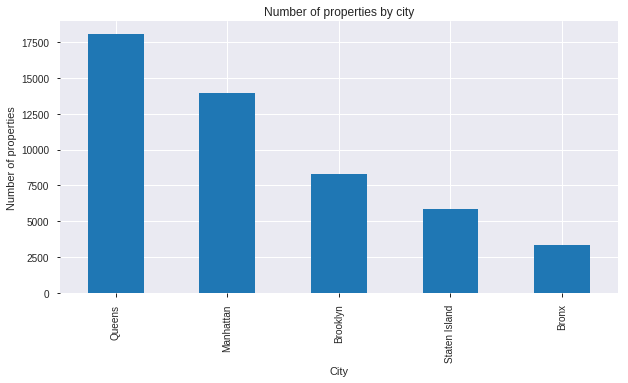

In [0]:
%matplotlib inline
df_prop.borough_name.value_counts().nlargest(10).plot(kind='bar', figsize=(10,5))
plt.title("Number of properties by city")
plt.ylabel('Number of properties')
plt.xlabel('City');
plt.show()

#### Distribution of Sale Price

In [0]:
df_prop['SALE PRICE'].describe()

count    4.950400e+04
mean     1.127438e+06
std      1.638281e+06
min      1.162000e+03
25%      4.024270e+05
50%      6.474200e+05
75%      1.100000e+06
max      1.527500e+07
Name: SALE PRICE, dtype: float64

**Observation**: The maximum sale price is 15 million

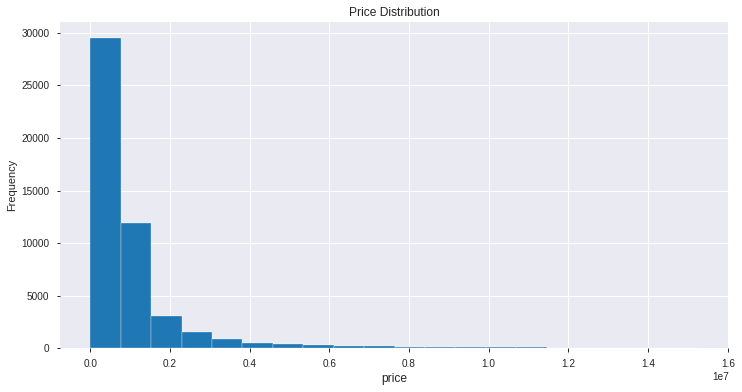

In [0]:
df_prop['SALE PRICE'].plot.hist(bins=20, figsize=(12, 6), edgecolor = 'white')
plt.xlabel('price', fontsize=12)
plt.title('Price Distribution', fontsize=12)
plt.show()

**Observation**: The distribution is highly skewed towards the right which implies there are **lesser properties that have a very high prices**.  


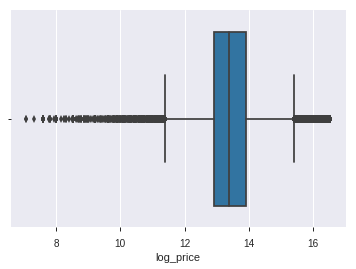

In [0]:
df_prop["log_price"] = np.log(df_prop["SALE PRICE"] + 1)
sns.boxplot(df_prop.log_price)


In [0]:
#skewness and kurtosis
print("Skewness: %f" % df_prop['SALE PRICE'].skew())
print("Kurtosis: %f" % df_prop['SALE PRICE'].kurt())

Skewness: 4.322486
Kurtosis: 23.126278


#### Correlation between selected variables

The heat map produces a correlation plot between variables of the dataframe.

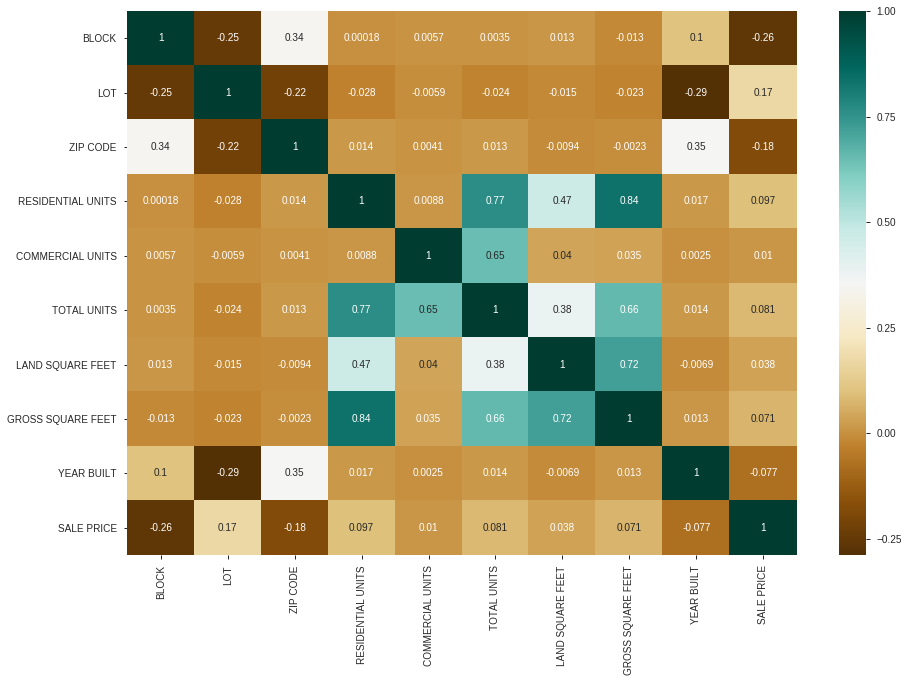

In [0]:
plt.figure(figsize=(15,10))
c = df_prop[df_prop.columns.values[0:19]].corr()
sns.heatmap(c,cmap="BrBG",annot=True)

**Observation**: The heat map illustrates that sale price is independent of all column values that could be considered for linear regression.

#### Explore how gross square feet affects sale price 

In [0]:
configure_plotly_browser_state()
px.scatter(df_prop, x="GROSS SQUARE FEET", y="SALE PRICE", size ="TOTAL UNITS" ,color="borough_name",
           hover_data=["BUILDING CLASS CATEGORY","LOT"], log_x=True, size_max=60)

**Observation:** 

- Properties with more total units do not fetch larger sales price
- Properties in Staten Island have comparitively lesser sales price in comparison with other boroughs in New york city

#### Explore how tax class at the time of sale affect sales price

In [0]:
configure_plotly_browser_state()
px.box(df_prop, x="borough_name", y="SALE PRICE", color="TAX CLASS AT TIME OF SALE",hover_data=['NEIGHBORHOOD', 'BUILDING CLASS CATEGORY'],notched=True)

**Observation:** 

- Manhatten has the highest priced properties that have a tax class 1 representing  residential property of up to three units (such as one-,two-, and three-family homes and small stores or offices with one or two attached apartments) as compared to other boroughs. 
- Properties in Staten Island have comparitively lesser sales price in comparison with other boroughs in New york city

In [0]:
configure_plotly_browser_state()
px.box(df_prop, x="SALE PRICE", notched=True, hover_data=['borough_name'], orientation='h')


In [0]:
configure_plotly_browser_state()
px.box(df_prop, x="day_week", y="SALE PRICE", color="TAX CLASS AT TIME OF SALE", notched=True)

**Observation:** 

- On Saturdays there are no sales for the tax class 4 which represents properties such as  such as offices, factories, warehouses, garage buildings, etc. 

## Model Building

###  Prepare the Data for model building

#### Delete columns not necessary for prediction

In [0]:
df_prop_lin.columns

Index(['BOROUGH', 'NEIGHBORHOOD', 'BUILDING CLASS CATEGORY',
       'TAX CLASS AT PRESENT', 'BLOCK', 'LOT', 'BUILDING CLASS AT PRESENT',
       'ADDRESS', 'APARTMENT NUMBER', 'ZIP CODE', 'RESIDENTIAL UNITS',
       'COMMERCIAL UNITS', 'TOTAL UNITS', 'LAND SQUARE FEET',
       'GROSS SQUARE FEET', 'YEAR BUILT', 'TAX CLASS AT TIME OF SALE',
       'BUILDING CLASS AT TIME OF SALE', 'SALE PRICE', 'SALE DATE'],
      dtype='object')

In [0]:
#Dropping few columns
del df_prop_lin['BUILDING CLASS AT PRESENT']
del df_prop_lin['BUILDING CLASS AT TIME OF SALE']
del df_prop_lin['NEIGHBORHOOD']
del df_prop_lin['ADDRESS']
del df_prop_lin['SALE DATE']
del df_prop_lin['APARTMENT NUMBER']
del df_prop_lin['RESIDENTIAL UNITS']
del df_prop_lin['COMMERCIAL UNITS']


#### Perform one-hot encoding for categorical variables

In [0]:
#Select the variables to be one-hot encoded
one_hot_features = ['BOROUGH', 'BUILDING CLASS CATEGORY','TAX CLASS AT PRESENT','TAX CLASS AT TIME OF SALE']
# Convert categorical variables into dummy/indicator variables (i.e. one-hot encoding).
one_hot_encoded = pd.get_dummies(df_prop_lin[one_hot_features],drop_first=True)
one_hot_encoded.info(verbose=True, memory_usage=True, null_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 49504 entries, 31578 to 65394
Data columns (total 59 columns):
BOROUGH_2                                                               49504 non-null uint8
BOROUGH_3                                                               49504 non-null uint8
BOROUGH_4                                                               49504 non-null uint8
BOROUGH_5                                                               49504 non-null uint8
BUILDING CLASS CATEGORY_02 TWO FAMILY DWELLINGS                         49504 non-null uint8
BUILDING CLASS CATEGORY_03 THREE FAMILY DWELLINGS                       49504 non-null uint8
BUILDING CLASS CATEGORY_04 TAX CLASS 1 CONDOS                           49504 non-null uint8
BUILDING CLASS CATEGORY_05 TAX CLASS 1 VACANT LAND                      49504 non-null uint8
BUILDING CLASS CATEGORY_06 TAX CLASS 1 - OTHER                          49504 non-null uint8
BUILDING CLASS CATEGORY_07 RENTALS - WALKUP APARTM

In [0]:
# Replacing categorical columns with dummies
fdf = df_prop_lin.drop(one_hot_features,axis=1)
fdf = pd.concat([fdf, one_hot_encoded] ,axis=1)


In [0]:
fdf.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 49504 entries, 31578 to 65394
Data columns (total 67 columns):
BLOCK                                                                   49504 non-null int64
LOT                                                                     49504 non-null int64
ZIP CODE                                                                49504 non-null int64
TOTAL UNITS                                                             49504 non-null int64
LAND SQUARE FEET                                                        49504 non-null float64
GROSS SQUARE FEET                                                       49504 non-null float64
YEAR BUILT                                                              49504 non-null int64
SALE PRICE                                                              49504 non-null int64
BOROUGH_2                                                               49504 non-null uint8
BOROUGH_3                                     

#### Standardization

In [0]:
#Standardize rows into uniform scale

X = fdf.drop(['SALE PRICE'],axis=1)
y = fdf['SALE PRICE']

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X)

# Scale and center the data
fdf_normalized = scaler.transform(X)

# Create a pandas DataFrame
fdf_normalized = pd.DataFrame(data=X, index=X.index, columns=X.columns)





#### Split the data into train and test

In [0]:
X_train, X_test, y_train, y_test = train_test_split(fdf_normalized,y)

### Train the model

In [0]:
# initialize the model
lr= LinearRegression()

# fit the model
model_fit=lr.fit(X_train,y_train)

In [0]:
#predict on test data
train_pred = model_fit.predict(X_train)

#mean squared error
mse=mean_squared_error(y_train,train_pred)

#root mean squared error
print('train rmse: {}'.format(np.sqrt(mse)))

#mean absolute error
mae=mean_absolute_error(y_train,train_pred)
print('train mae: {}'.format(mae))

train rmse: 1289201.3679944256
train mae: 661610.8795592046


### Test the model

In [0]:
#predict on test data
test_pred = model_fit.predict(X_test)

In [0]:
#mean squared error
mse=mean_squared_error(y_test,test_pred)

#root mean squared error
print('test rmse: {}'.format(np.sqrt(mse)))

#mean absolute error
mae=mean_absolute_error(y_train,train_pred)
print('train mae: {}'.format(mae))

test rmse: 1333882.1195485573
train mae: 661610.8795592046


In [0]:
len(test_pred)

12376

## Model Explainability

### LIME

In [0]:
# Import lime package
import lime
import lime.lime_tabular

#Find caegorical features
categorical_features = np.argwhere(np.array([len(set(X_test.values[:,x])) for x in range(X_test.values.shape[1])]) <= 10).flatten()
#Lime explainer for regression
explainer = lime.lime_tabular.LimeTabularExplainer(X_test.values,
feature_names=X_test.columns.values.tolist(),
class_names=['PriceCrore'],
categorical_features=categorical_features,
verbose=True, mode='regression')
ind = 4
#Fit on test data
exp = explainer.explain_instance(X_test.values[ind], model_fit.predict, num_features=6)
#Show in notebook features influencing predictions
exp.show_in_notebook(show_table=True)

Intercept -6375293.085849316
Prediction_local [223349.24663561]
Right: 923245.768068213


### ELI5

In [0]:
# Import Eli5 package
import eli5
from eli5.sklearn import PermutationImportance

# Find the importance of columns for prediction
perm = PermutationImportance(model_fit, random_state=1).fit(X_test,test_pred)
eli5.show_weights(perm, feature_names = X_test.columns.tolist())

Weight,Feature
3.4236 ± 0.0569,TAX CLASS AT PRESENT_1
1.9263 ± 0.0155,BUILDING CLASS CATEGORY_10 COOPS - ELEVATOR APARTMENTS
1.2210 ± 0.0192,TAX CLASS AT PRESENT_2A
0.6959 ± 0.0099,BOROUGH_4
0.6466 ± 0.0184,BUILDING CLASS CATEGORY_13 CONDOS - ELEVATOR APARTMENTS
0.6397 ± 0.0075,BOROUGH_5
0.5943 ± 0.0043,TAX CLASS AT PRESENT_2
0.5638 ± 0.0060,BUILDING CLASS CATEGORY_09 COOPS - WALKUP APARTMENTS
0.4836 ± 0.0058,BUILDING CLASS CATEGORY_07 RENTALS - WALKUP APARTMENTS
0.4048 ± 0.0068,BOROUGH_2


In [0]:
#Understanding how each feature influences the prediction
eli5.show_prediction(model_fit, doc=X_test.iloc[[ind]], feature_names=list(X_test.columns))

### SHAP

In [0]:
#Import SHAP package
import shap

#Create explainer for linear model
explainer = shap.LinearExplainer(model_fit,data=X_test.values)
shap_values = explainer.shap_values(X_test)

In [0]:
#Understanding how each feature influences the prediction

shap.initjs()
ind = 11


shap.force_plot(
    explainer.expected_value, shap_values[ind,:], X_test.iloc[ind,:],
    feature_names=X_test.columns.tolist()
)

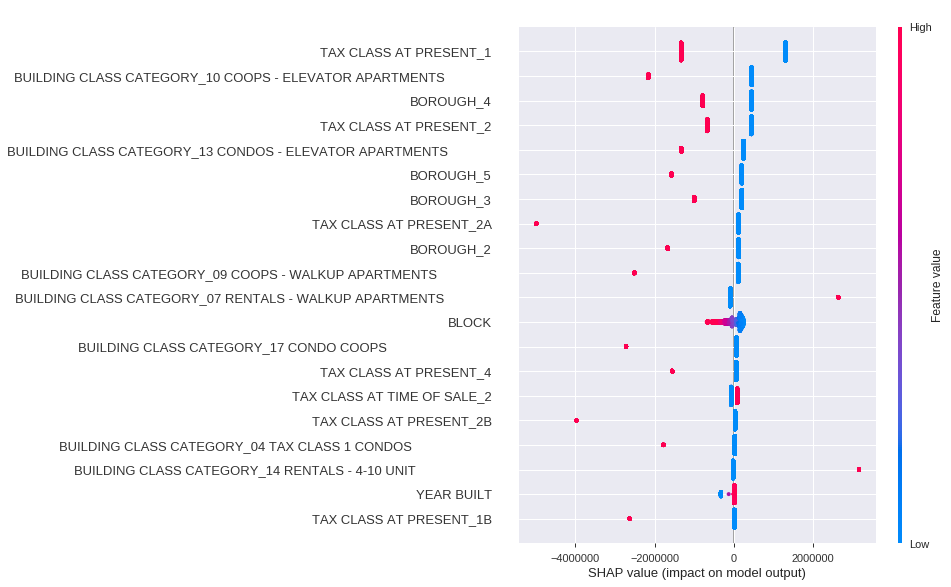

In [0]:

shap.summary_plot(shap_values,X_test)


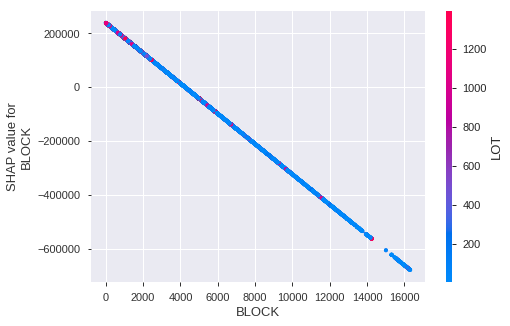

In [0]:
shap.dependence_plot("BLOCK", shap_values, X_test)